In [64]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

In [65]:
img_path = '/export/data/mdorkenw/data/alaska2/'
methods = ['Cover', 'JMiPOD', 'JUNIWARD', 'UERD']

In [71]:
## Select random images for visualization
images = os.listdir(img_path + 'Cover/')
compression = np.load(img_path + 'JPEG_compression.npy')
rand = np.random.randint(0, len(images), 60)
rand_img = [images[i] for i in rand]

## Visualization of difference images

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

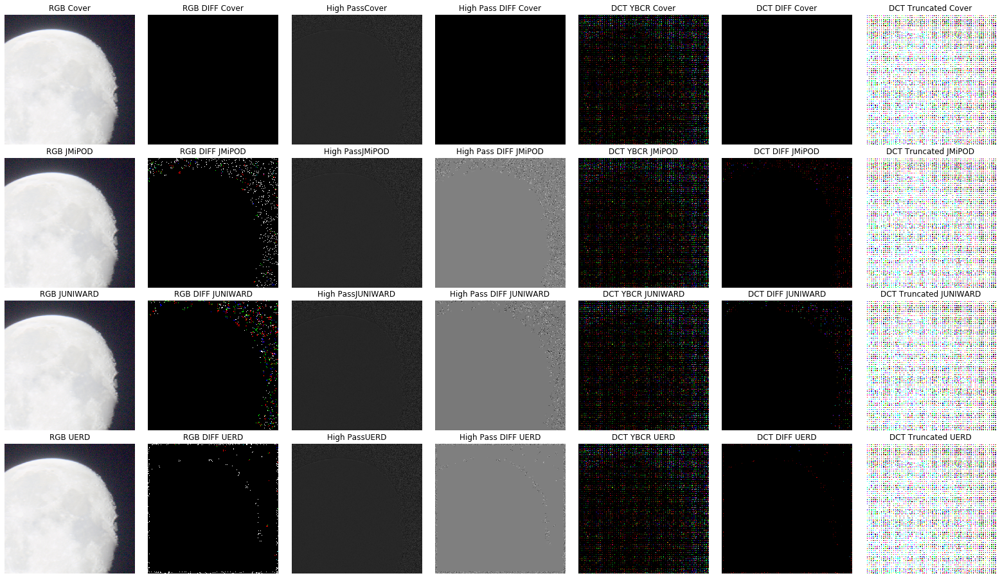

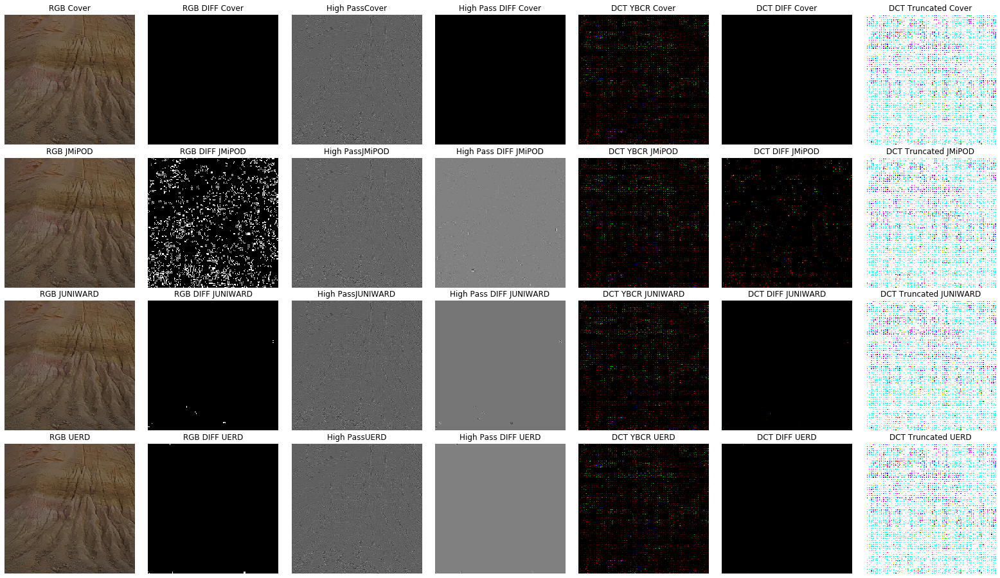

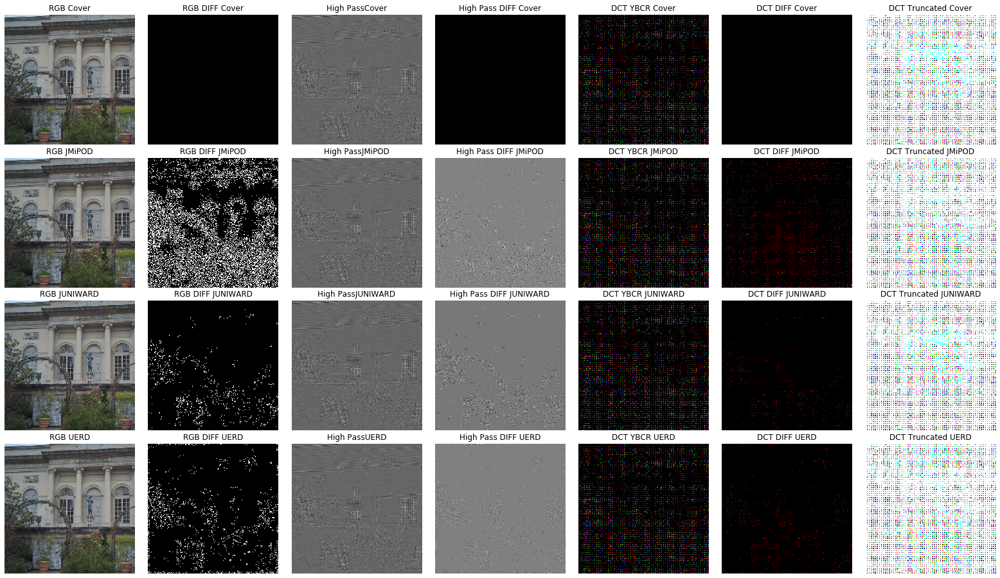

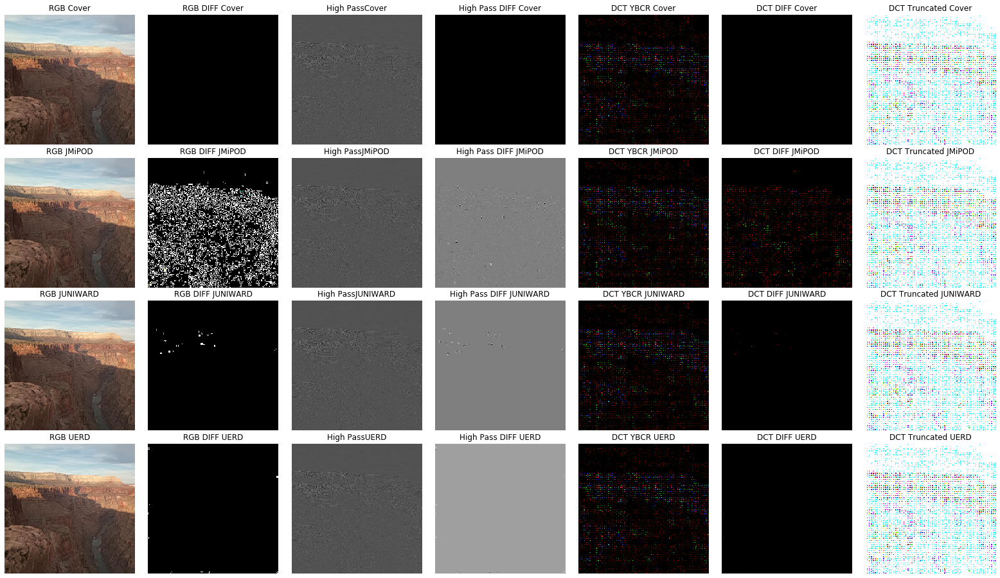

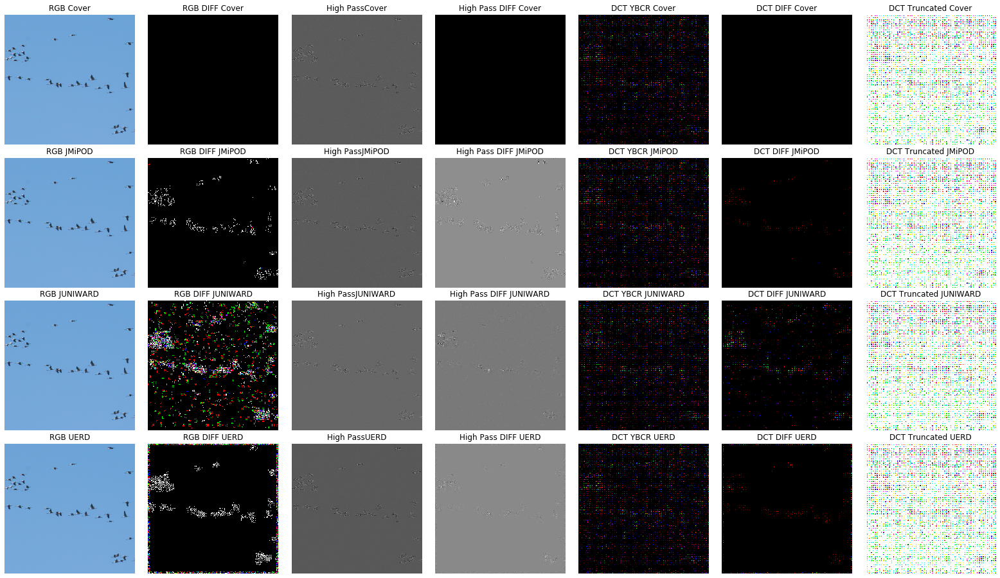

...

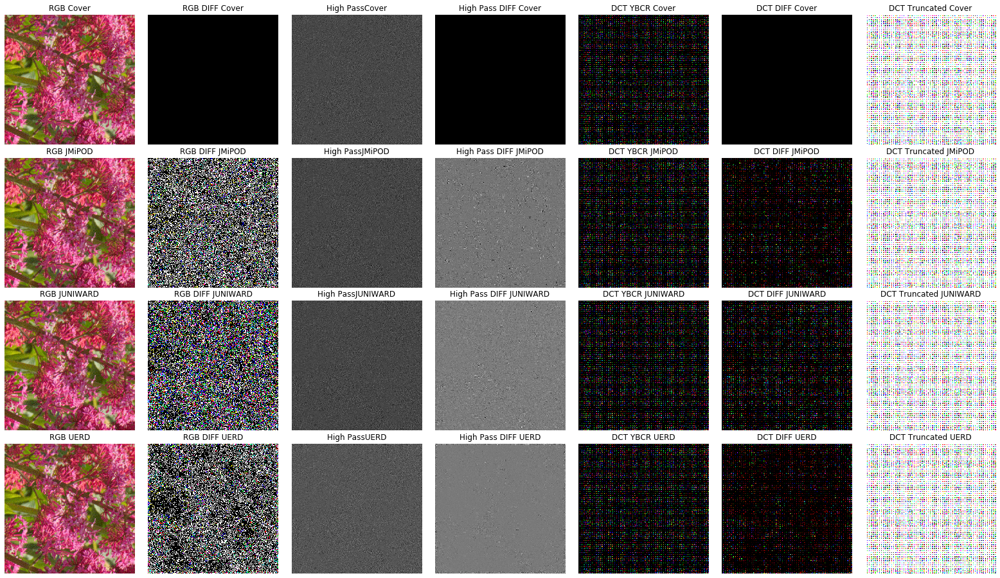

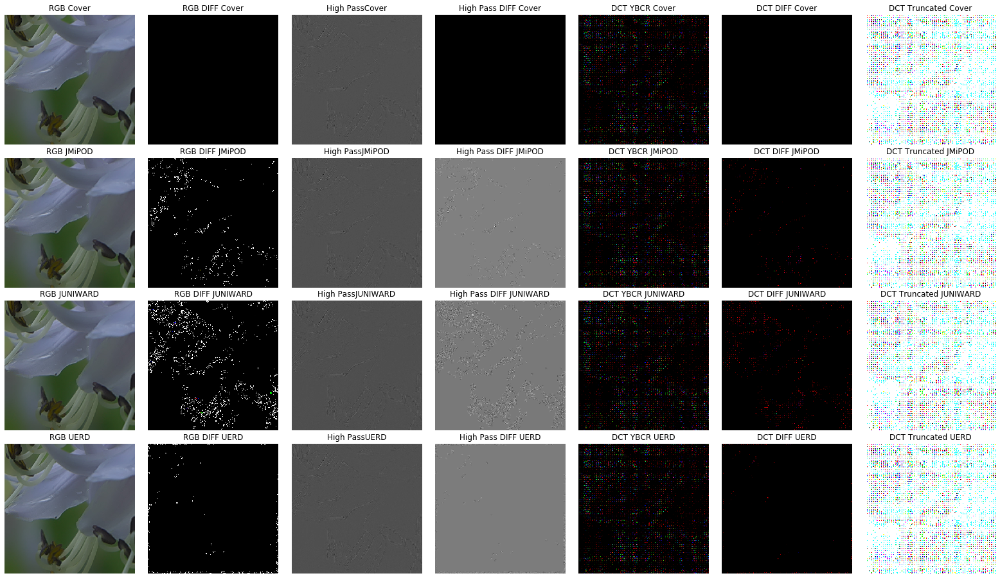

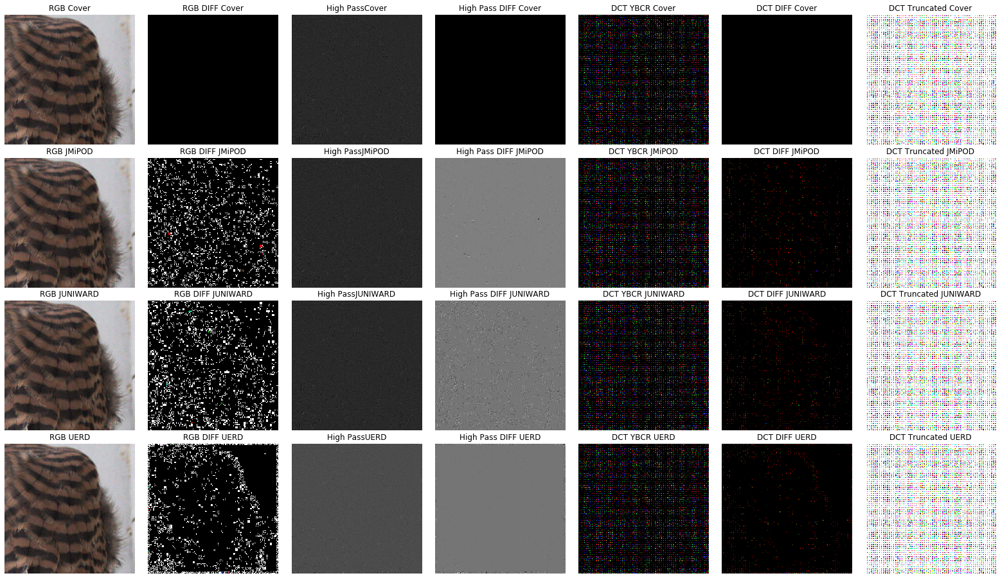

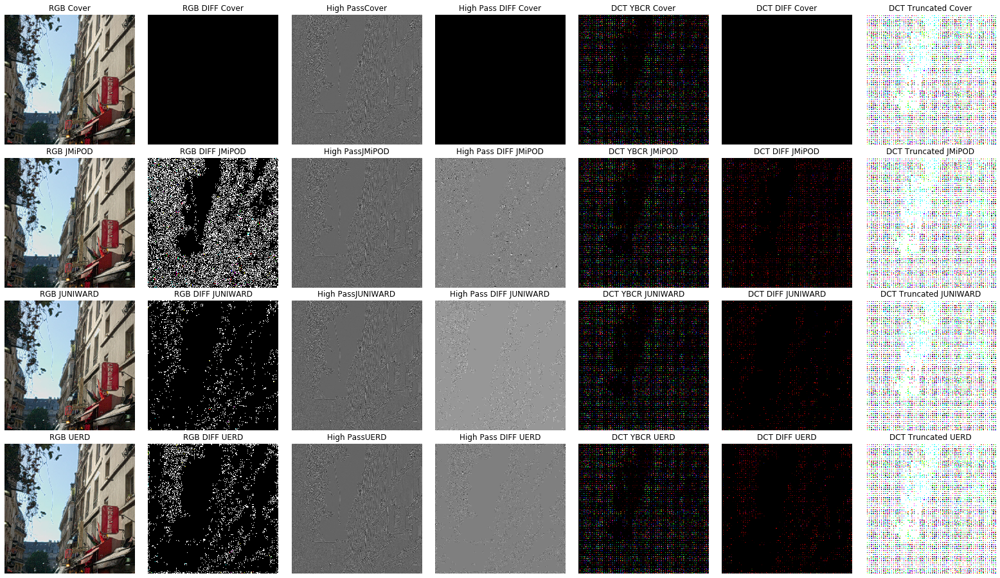

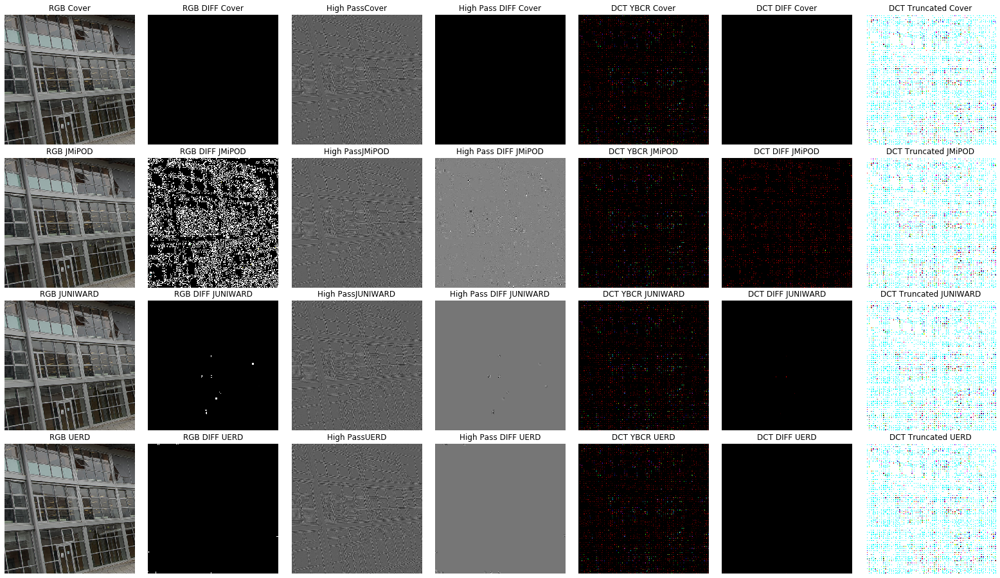

In [73]:
from numpy import r_
from scipy.fftpack import dct

def to_DCT(im):
    def apply_dct(a):
        return dct(dct( a, axis=0, norm='ortho'), axis=1, norm='ortho')
    imsize = im.shape
    dct2 = np.zeros(imsize)

    # Do 8x8 DCT on image (in-place)
    for i in r_[:imsize[0]:8]:
        for j in r_[:imsize[1]:8]:
            dct2[i:(i+8),j:(j+8)] = apply_dct(im[i:(i+8),j:(j+8)])
            dct2[i:(i+8),j:(j+4)] = np.zeros((8,4,3))
            dct2[i:(i+4),j:(j+8)] = np.zeros((4,8,3))
    return dct2

import torch
from torchvision import transforms

high_pass_filter = torch.nn.Conv2d(1, 1, 3, 1, 1, bias=False)
kernel = torch.from_numpy(np.array([[0, -1 / 4, 0], [-1 / 4, 1, -1 / 4], [0, -1 / 4, 0]]))
high_pass_filter.weight = torch.nn.Parameter(kernel.unsqueeze(0).unsqueeze(0).float())

for jo in range(20):
    fig, axs = plt.subplots(4, 7, figsize=(28,16))
    fig.subplots_adjust(hspace = 0.1, wspace=.001)

    methods = ['Cover', 'JMiPOD', 'JUNIWARD', 'UERD']

    imgs = [Image.open(img_path + met + '/' + rand_img[jo]) for met in methods]

    for i in range(4):
        for j in range(7):
            image = imgs[i]
            if j == 0:
                axs[i, j].imshow(image)
                axs[i, j].set_title('RGB ' + methods[i])
                axs[i, j].axis('off')
            if j == 1:
                axs[i, j].imshow(np.array(imgs[0])-np.array(image))
                axs[i, j].set_title('RGB DIFF ' + methods[i])
                axs[i, j].axis('off')
            if j == 2:
                image = high_pass_filter(transforms.ToTensor()(image.convert('L')).unsqueeze(0)).squeeze().detach().numpy()
                axs[i, j].imshow(image, cmap = 'gray')
                axs[i, j].set_title('High Pass' + methods[i])
                axs[i, j].axis('off')
            if j ==3:
                image1 = high_pass_filter(transforms.ToTensor()(image.convert('L')).unsqueeze(0)).squeeze().detach().numpy()
                image2 = high_pass_filter(transforms.ToTensor()(imgs[0].convert('L')).unsqueeze(0)).squeeze().detach().numpy()
                axs[i, j].imshow(image2-image1, cmap = 'gray')
                axs[i, j].set_title('High Pass DIFF ' + methods[i])
                axs[i, j].axis('off')
            if j == 4:
                image = np.array(image.convert('YCbCr'))
                axs[i, j].imshow(to_DCT(image).astype(float), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
                axs[i, j].axis('off')
                axs[i, j].set_title('DCT YBCR ' + methods[i])
            if j == 5:
                image = to_DCT(np.array(imgs[0].convert('YCbCr')))- to_DCT(np.array(image.convert('YCbCr')))
                axs[i, j].imshow(image.astype(float), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
                axs[i, j].axis('off')
                axs[i, j].set_title('DCT DIFF ' + methods[i])
            if j == 6:
                image = np.array(image.convert('YCbCr'))
#                 image = np.abs(image)/image.max()
                axs[i, j].imshow(1/(to_DCT(image)+1e-3).astype(float), cmap='gray')
                axs[i, j].axis('off')
                axs[i, j].set_title('DCT Truncated ' + methods[i])
                
#             if j == 5:
#                 image = np.array(image)
#                 axs[i, j].imshow(to_DCT(image).astype(float), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
#                 axs[i, j].axis('off')
#                 axs[i, j].set_title('DCT RGB' + methods[i])
#             if j == 6:
#                 image = to_DCT(np.array(images[0]))- to_DCT(np.array(image))
#                 axs[i, j].imshow(image.astype(float), cmap='gray', vmax = np.max(image)*0.01, vmin = 0)
#                 axs[i, j].axis('off')
#                 axs[i, j].set_title('DCT DIFF RGB' + methods[i])
                
    plt.savefig('visualization/diff_img/img' + str(jo) + '.png', dpi=100)

## Visualization of different JPEG compressions

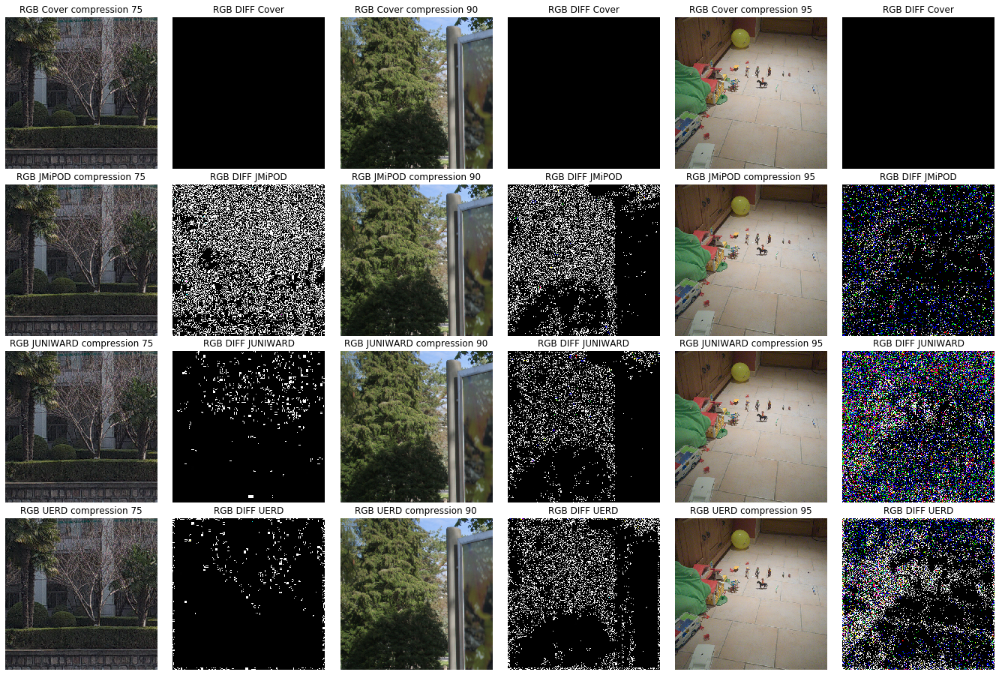

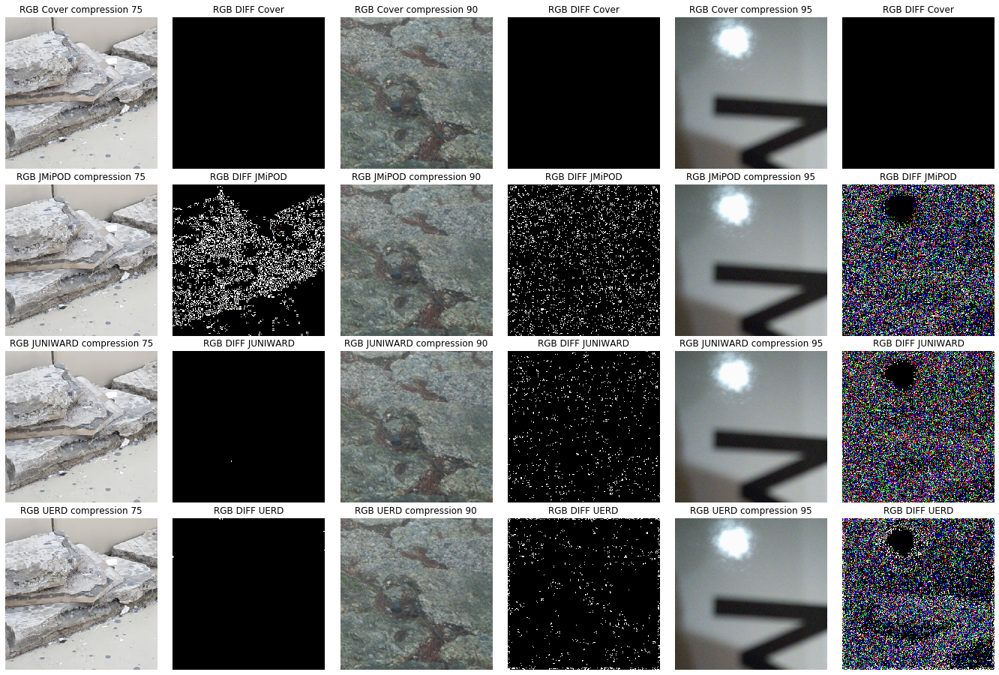

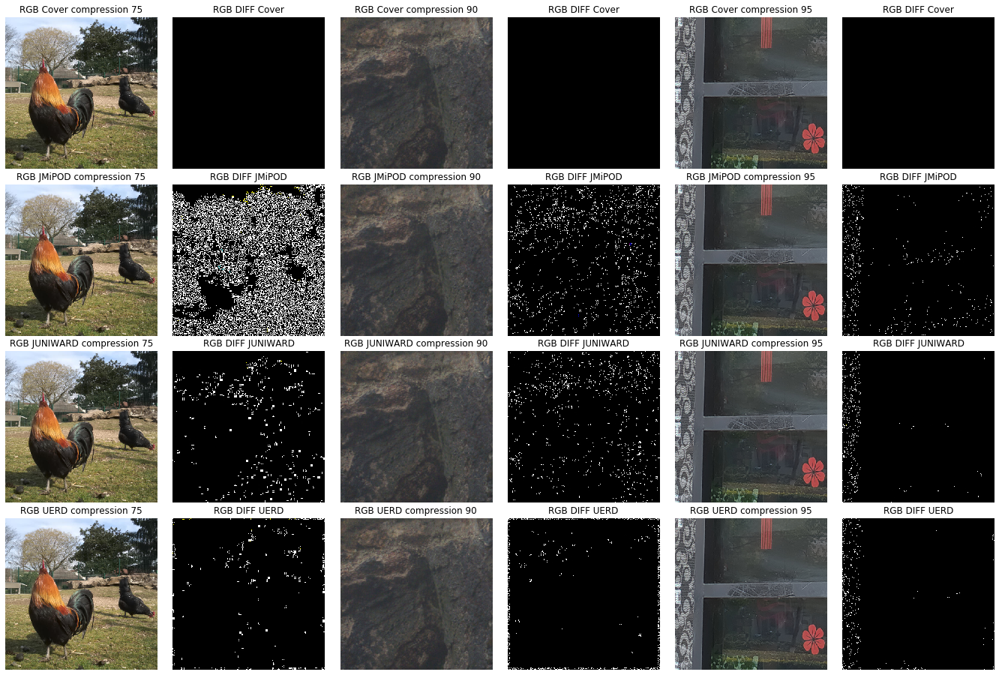

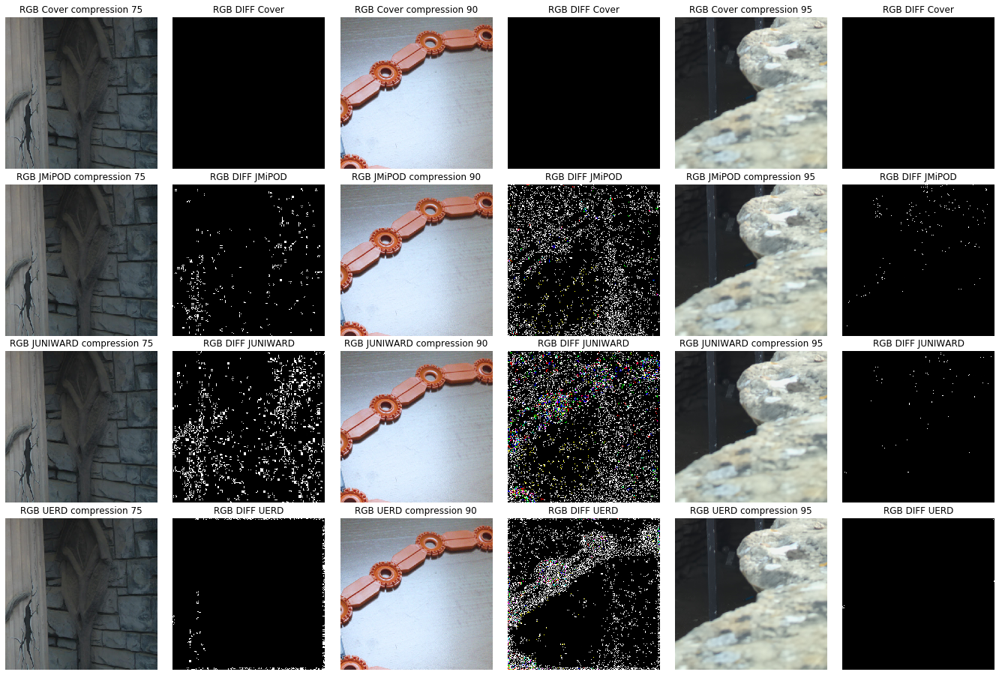

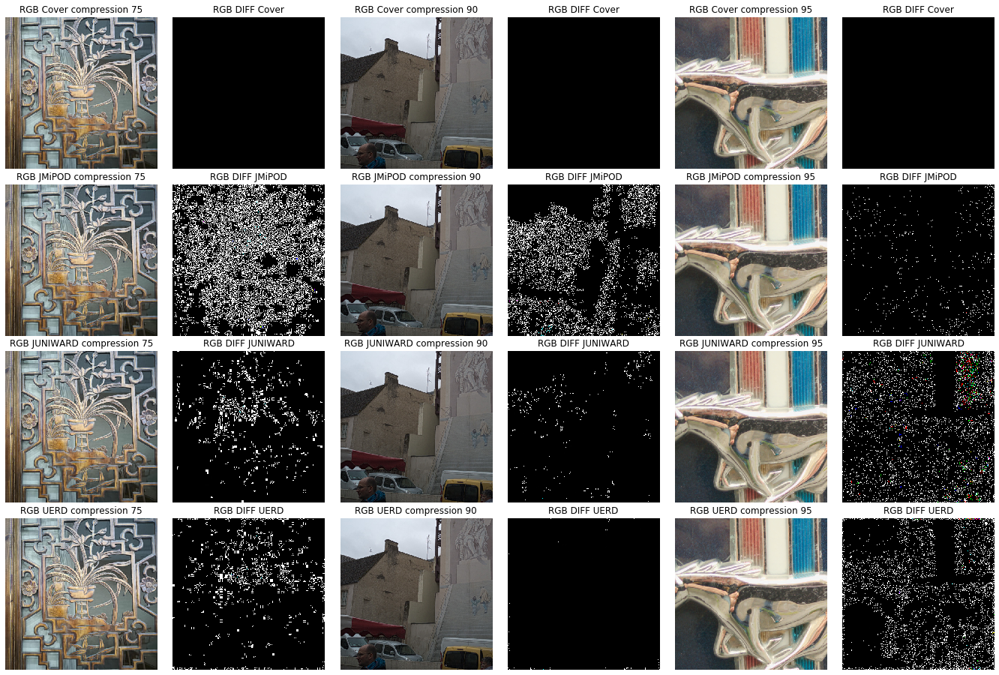

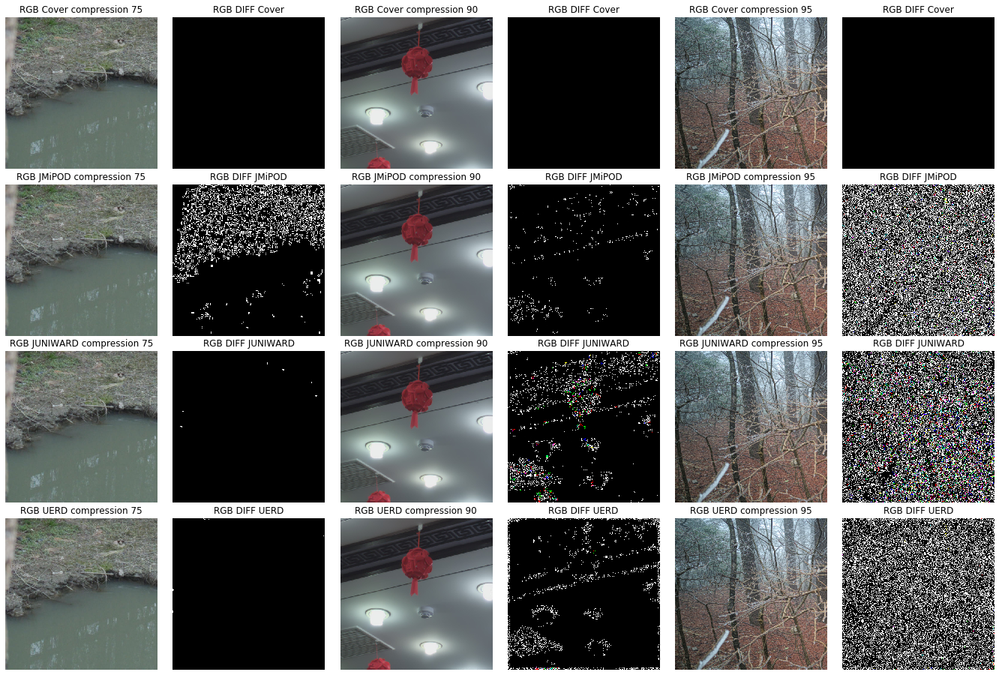

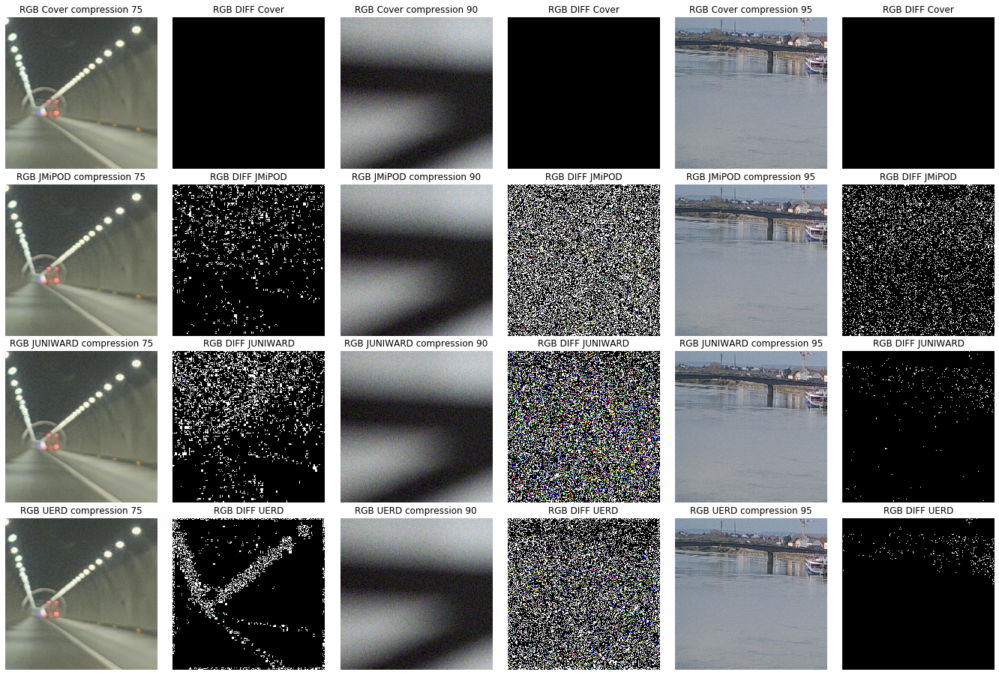

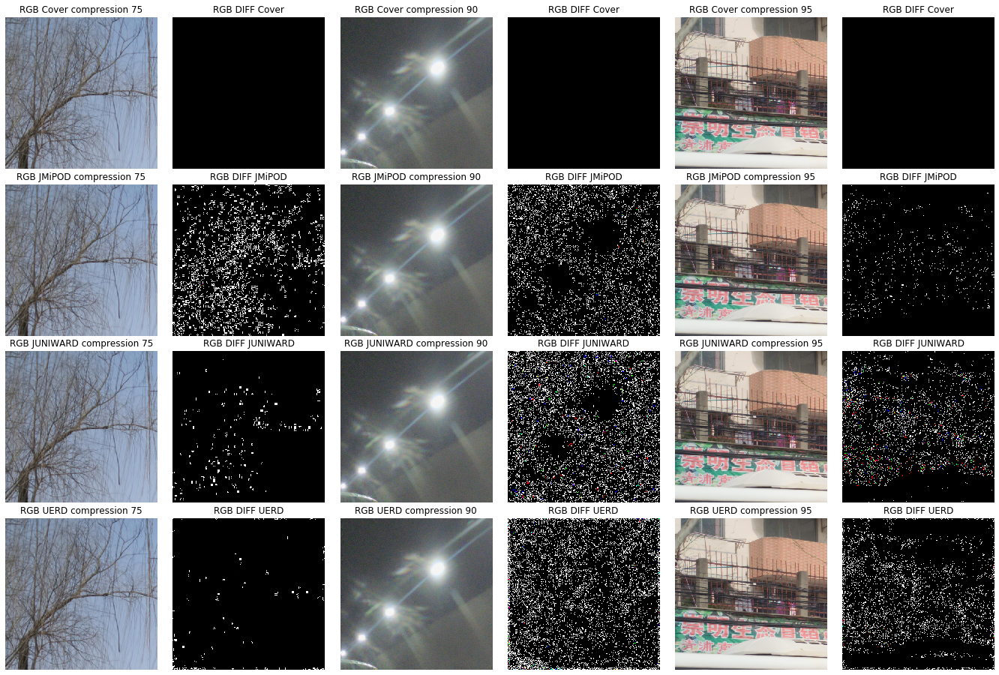

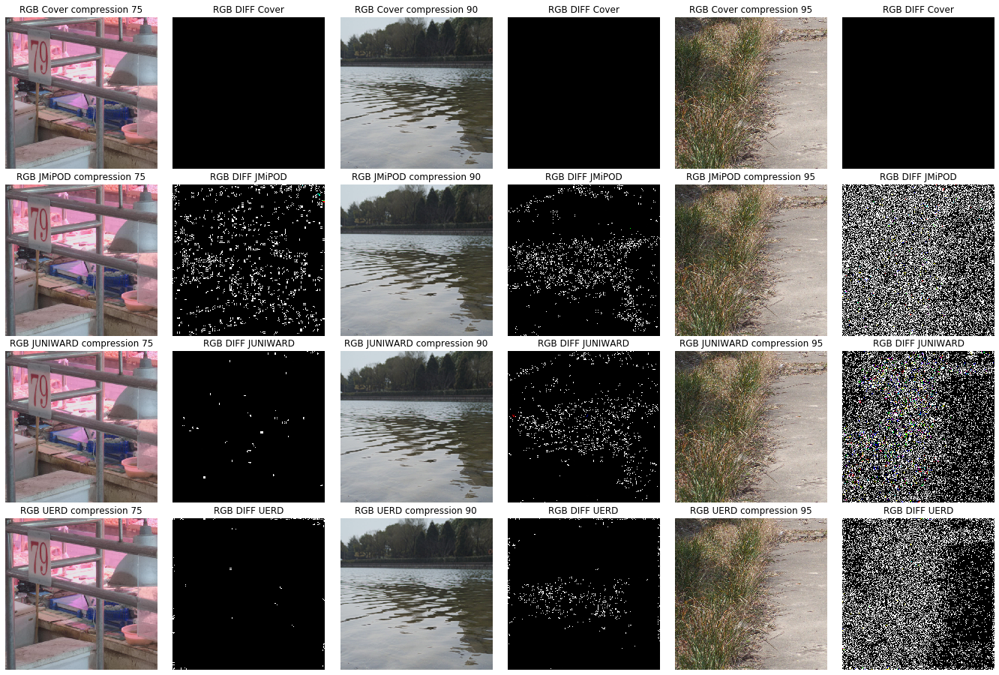

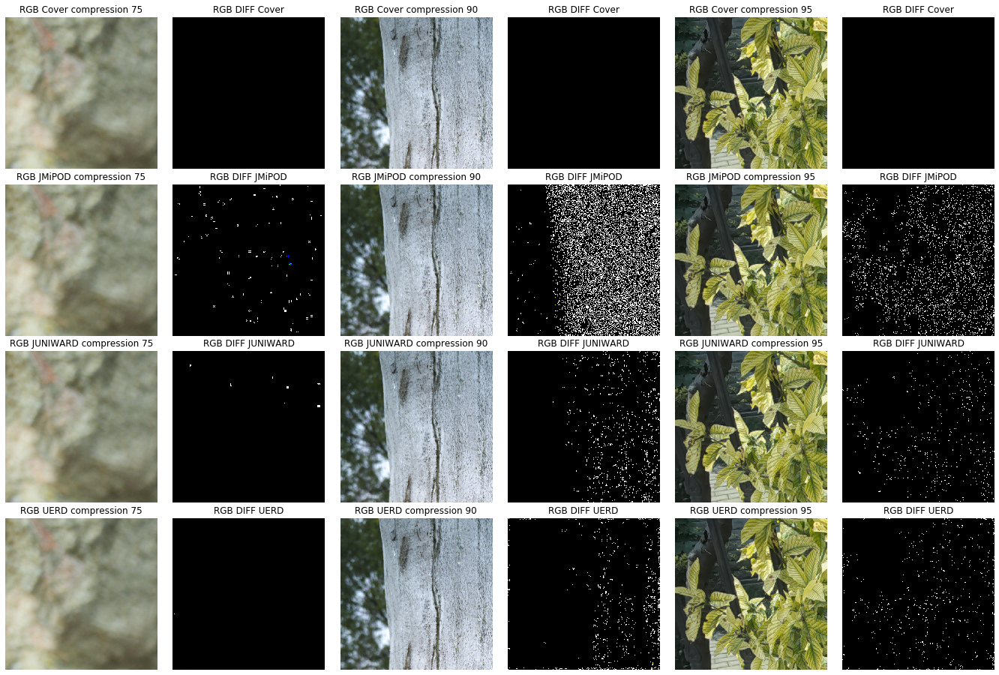

In [74]:
for jo in range(10):
    fig, axs = plt.subplots(4, 6, figsize=(24,16))
    fig.subplots_adjust(hspace = 0.1, wspace=.001)
    for h in range(3):
        methods = ['Cover', 'JMiPOD', 'JUNIWARD', 'UERD']
        compre = ['75', '90', '95']
        index = np.where(compression==h)[0][jo]
        imgs = [Image.open(img_path + met + '/' + images[index]) for met in methods]

        for i in range(4):
            for j in range(2):
                image = imgs[i]
                if j == 0:
                    axs[i, j + h*2].imshow(image)
                    axs[i, j + h*2].set_title('RGB ' + methods[i] + f' compression {compre[h]}')
                    axs[i, j + h*2].axis('off')
                if j == 1:
                    axs[i, j + h*2].imshow(np.array(imgs[0])-np.array(image))
                    axs[i, j + h*2].set_title('RGB DIFF ' + methods[i])
                    axs[i, j + h*2].axis('off')
#     plt.show()
    plt.savefig('visualization/compression/img_' + str(jo) + '.png', dpi=100)

In [57]:
## Cell takes 2.5 h to run all differences between all methods and all compression
from tqdm import trange
diff = [[0, 0, 0], [0, 0, 0], [0, 0, 0]]
for h in range(3):
    index = np.where(compression==h)[0]
    for i in trange(len(index)):
        imgs = [Image.open(img_path + met + '/' + images[index[i]]) for met in methods]
        for j in range(3):
            diff[h][j] += np.mean(np.abs(np.array(imgs[0])-np.array(imgs[j+1]))) 

100%|██████████| 25000/25000 [49:20<00:00,  8.44it/s]  


In [62]:
diff2 = np.array(diff)
diff2 /= (25000/3)
diff2

array([[135.26404548,  88.60636477,  79.83947414],
       [151.39804545, 106.55098764, 105.15982109],
       [111.52171979, 107.14310402, 108.88231014]])

([array([0., 0., 0., 0., 1., 0., 0., 1., 0., 1.]),
  array([0., 1., 0., 2., 0., 0., 0., 0., 0., 0.]),
  array([1., 0., 0., 1., 1., 0., 0., 0., 0., 0.])],
 array([ 79.83947414,  86.99533127,  94.1511884 , 101.30704553,
        108.46290266, 115.61875979, 122.77461692, 129.93047406,
        137.08633119, 144.24218832, 151.39804545]),
 <a list of 3 Lists of Patches objects>)

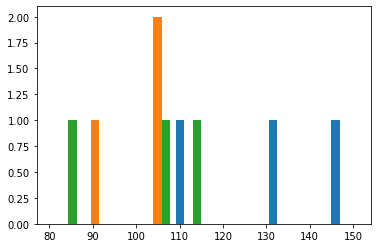

## Visualization of features

Code taken from https://github.com/utkuozbulak/pytorch-cnn-visualizations

In [82]:
import sys
model_path = '/export/data/mdorkenw/results/alaska/'
model_name = 'Model_Date-2020-7-16-9-26_Efficientnet-CORRECT_SUBMISSION_125050_SMOOTHING0.2'
sys.path.append(model_path + model_name + '/code')
import network as net
import dataloader 
import auxiliaries as aux
os.environ["CUDA_VISIBLE_DEVICES"] = '0'
config     = aux.extract_setup_info(model_path + model_name + '/code/network_base_setup.txt')[0]
dloader   = dataloader.dataset(config, mode='test')
model = net.Net(config.Network).cuda()
pre_model = torch.load(model_path + model_name + '/checkpoint_best_val.pth.tar')
_ = model.load_state_dict(pre_model['state_dict'])

Loaded pretrained weights for efficientnet-b0


'/export/data/mdorkenw/data/alaska2/Cover/00019.jpg'

In [91]:
sys.path.append('/export/home/mdorkenw/code/ALASKA2/scripts/pytorch-cnn-visualizations/src/')
from guided_backprop import GuidedBackprop
from misc_functions import get_example_params, convert_to_grayscale, save_gradient_images, get_positive_negative_saliency

file_name_to_export = 'visualization/feature/img'
prep_img = dloader.load_and_augment_RGB(img_path + 'Cover' + '/' + images[index])
target_class = dloader.get_1hot_(1)

# Guided backprop
GBP = GuidedBackprop(model)
# Get gradients
guided_grads = GBP.generate_gradients(prep_img, target_class)
# Save colored gradients
save_gradient_images(guided_grads, file_name_to_export + '_Guided_BP_color')
# Convert to grayscale
grayscale_guided_grads = convert_to_grayscale(guided_grads)
# Save grayscale gradients
save_gradient_images(grayscale_guided_grads, file_name_to_export + '_Guided_BP_gray')
# Positive and negative saliency maps
pos_sal, neg_sal = get_positive_negative_saliency(guided_grads)
save_gradient_images(pos_sal, file_name_to_export + '_pos_sal')
save_gradient_images(neg_sal, file_name_to_export + '_neg_sal')
print('Guided backprop completed')

AttributeError: 'Net' object has no attribute 'features'